In [64]:
import numpy as np
import pandas as pd
import torch

Что ж, я полагаю, нам для начала нужны данные временного ряда. Будь то платежные операции или данные фондовой биржи, данные временных рядов есть везде. Одним из таких общедоступных наборов данных являются данные Почасовое потребление энергии PJM, одномерный набор данных временных рядов за 10+ лет почасовых наблюдений, собранных в разных регионах США. Я буду использовать данные по восточному региону PJM, которые изначально содержат данные о почасовом потреблении энергии с 2001 по 2018 год, но любой из наборов данных, представленных в ссылке, должен работать.

In [65]:
df = pd.read_csv("../data/pjm/PJME_hourly.csv")
df.head()

,Datetime,PJME_MW
0,2002-12-31 01:00:00,26498.0
1,2002-12-31 02:00:00,25147.0
2,2002-12-31 03:00:00,24574.0
3,2002-12-31 04:00:00,24393.0
4,2002-12-31 05:00:00,24860.0


In [66]:
import plotly.graph_objs as go
from plotly.offline import iplot


def plot_dataset(df: pd.DataFrame, title: str):
    """Plot time series

    Args:
        df (pd.DataFrame): _description_
        title (str): _description_
    """
    data = []
    value = go.Scatter(
        x=df.index,
        y=df.value,
        mode="lines",
        name="values",
        marker=dict(),
        text=df.index,
        line=dict(color="rgba(0,0,0, 0.3)"),
    )
    data.append(value)

    layout = dict(
        title=title,
        xaxis=dict(title="Date", ticklen=5, zeroline=False),
        yaxis=dict(title="Value", ticklen=5, zeroline=False),
    )

    fig = dict(data=data, layout=layout)
    iplot(fig)

In [67]:
import pandas as pd

df = df.set_index(["Datetime"])
df.index = pd.to_datetime(df.index)

In [68]:
df.head()

,PJME_MW
Datetime,
2002-12-31 01:00:00,26498.0
2002-12-31 02:00:00,25147.0
2002-12-31 03:00:00,24574.0
2002-12-31 04:00:00,24393.0
2002-12-31 05:00:00,24860.0


In [69]:
# Check if the index is sorted in ascending order
if not df.index.is_monotonic_increasing:
    df = df.sort_index()
df.head()

,PJME_MW
Datetime,
2002-01-01 01:00:00,30393.0
2002-01-01 02:00:00,29265.0
2002-01-01 03:00:00,28357.0
2002-01-01 04:00:00,27899.0
2002-01-01 05:00:00,28057.0


In [70]:
df = df.rename(columns={"PJME_MW": "value"})
plot_dataset(
    df, title="PJM East (PJME) Region: estimated energy consumption in Megawatts (MW)"
)

**Использование запаздывающих наблюдений как функций**

Начнем с использования временных шагов в качестве функций. Другими словами, мы пытаемся предсказать следующее значение, X (t + n), из предыдущих n наблюдений Xt, X + 1,… , и X (t + n-1). Затем нам нужно просто создать n столбцов с предыдущими наблюдениями. К счастью, Pandas предоставляет метод shift () для сдвига значений в столбце. Итак, мы можем написать цикл for для создания таких запаздывающих наблюдений, сдвинув значения в столбце на n раз и удалив первые n столбцов. Отставание - это просто, но это хорошая отправная точка, особенно если у вас не так много функций для работы с самого начала.

In [71]:
def generate_time_lags(df: pd.DataFrame, n_lags: int) -> pd.DataFrame:
    """Generate time lags

    Args:
        df (pd.DataFrame): _description_
        n_lags (int): _description_

    Returns:
        pd.DataFrame: _description_
    """
    df_n = df.copy()
    for n in range(1, n_lags + 1):
        df_n[f"lag{n}"] = df_n["value"].shift(n)
    df_n = df_n.iloc[n_lags:]
    return df_n


input_dim = 100

df_generated = generate_time_lags(df, input_dim)
df_generated

C:\Users\Иван\AppData\Local\Temp\ipykernel_26332\1264751044.py:13: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



,value,lag1,lag2,lag3,lag4,lag5,lag6,lag7,lag8,lag9,...,lag91,lag92,lag93,lag94,lag95,lag96,lag97,lag98,lag99,lag100
Datetime,,,,,,,,,,,,,,,,,,,,,
2002-01-05 05:00:00,26822.0,26669.0,27034.0,27501.0,28635.0,30924.0,33202.0,35368.0,36762.0,37539.0,...,30692.0,29943.0,29595.0,29308.0,28654.0,28057.0,27899.0,28357.0,29265.0,30393.0
2002-01-05 06:00:00,27399.0,26822.0,26669.0,27034.0,27501.0,28635.0,30924.0,33202.0,35368.0,36762.0,...,31395.0,30692.0,29943.0,29595.0,29308.0,28654.0,28057.0,27899.0,28357.0,29265.0
2002-01-05 07:00:00,28557.0,27399.0,26822.0,26669.0,27034.0,27501.0,28635.0,30924.0,33202.0,35368.0,...,31496.0,31395.0,30692.0,29943.0,29595.0,29308.0,28654.0,28057.0,27899.0,28357.0
2002-01-05 08:00:00,29709.0,28557.0,27399.0,26822.0,26669.0,27034.0,27501.0,28635.0,30924.0,33202.0,...,31031.0,31496.0,31395.0,30692.0,29943.0,29595.0,29308.0,28654.0,28057.0,27899.0
2002-01-05 09:00:00,31241.0,29709.0,28557.0,27399.0,26822.0,26669.0,27034.0,27501.0,28635.0,30924.0,...,30360.0,31031.0,31496.0,31395.0,30692.0,29943.0,29595.0,29308.0,28654.0,28057.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-08-02 20:00:00,44057.0,45641.0,46760.0,46816.0,46989.0,47154.0,46534.0,45372.0,43954.0,42189.0,...,28389.0,30789.0,33747.0,36581.0,37870.0,39089.0,40517.0,40709.0,39906.0,38637.0
2018-08-02 21:00:00,43256.0,44057.0,45641.0,46760.0,46816.0,46989.0,47154.0,46534.0,45372.0,43954.0,...,26779.0,28389.0,30789.0,33747.0,36581.0,37870.0,39089.0,40517.0,40709.0,39906.0
2018-08-02 22:00:00,41552.0,43256.0,44057.0,45641.0,46760.0,46816.0,46989.0,47154.0,46534.0,45372.0,...,25675.0,26779.0,28389.0,30789.0,33747.0,36581.0,37870.0,39089.0,40517.0,40709.0


In [72]:
df_features = (
    df.assign(hour=df.index.hour)
    .assign(day=df.index.day)
    .assign(month=df.index.month)
    .assign(day_of_week=df.index.dayofweek)
    .assign(week_of_year=df.index.isocalendar().week)
)

In [73]:
df_features

,value,hour,day,month,day_of_week,week_of_year
Datetime,,,,,,
2002-01-01 01:00:00,30393.0,1,1,1,1,1
2002-01-01 02:00:00,29265.0,2,1,1,1,1
2002-01-01 03:00:00,28357.0,3,1,1,1,1
2002-01-01 04:00:00,27899.0,4,1,1,1,1
2002-01-01 05:00:00,28057.0,5,1,1,1,1
...,...,...,...,...,...,...
2018-08-02 20:00:00,44057.0,20,2,8,3,31
2018-08-02 21:00:00,43256.0,21,2,8,3,31
2018-08-02 22:00:00,41552.0,22,2,8,3,31


In [74]:
def onehot_encode_pd(df, col_names):
    for col_name in col_names:
        dummies = pd.get_dummies(df[col_name], prefix=col_name)
        df = pd.concat([df, dummies], axis=1).drop(columns=[col_name])
    return df


df_features = onehot_encode_pd(
    df_features, ["month", "day", "day_of_week", "week_of_year"]
)

In [75]:
df_features.head()

,value,hour,month_1,month_2,month_3,month_4,month_5,month_6,month_7,month_8,...,week_of_year_44,week_of_year_45,week_of_year_46,week_of_year_47,week_of_year_48,week_of_year_49,week_of_year_50,week_of_year_51,week_of_year_52,week_of_year_53
Datetime,,,,,,,,,,,,,,,,,,,,,
2002-01-01 01:00:00,30393.0,1,True,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2002-01-01 02:00:00,29265.0,2,True,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2002-01-01 03:00:00,28357.0,3,True,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2002-01-01 04:00:00,27899.0,4,True,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2002-01-01 05:00:00,28057.0,5,True,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False


In [76]:
# Replacing True with 1 and False with 0
df_features = df_features.replace({True: 1, False: 0})

C:\Users\Иван\AppData\Local\Temp\ipykernel_26332\242271157.py:2: FutureWarning:

Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`



In [77]:
df_features.head()

,value,hour,month_1,month_2,month_3,month_4,month_5,month_6,month_7,month_8,...,week_of_year_44,week_of_year_45,week_of_year_46,week_of_year_47,week_of_year_48,week_of_year_49,week_of_year_50,week_of_year_51,week_of_year_52,week_of_year_53
Datetime,,,,,,,,,,,,,,,,,,,,,
2002-01-01 01:00:00,30393.0,1,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2002-01-01 02:00:00,29265.0,2,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2002-01-01 03:00:00,28357.0,3,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2002-01-01 04:00:00,27899.0,4,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2002-01-01 05:00:00,28057.0,5,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


**Создание циклических временных характеристик**

Как и все данные, над которыми мы работали до сих пор, некоторые данные по своей природе цикличны. Будь то часы, дни, недели или месяцы, все они следуют периодическим циклам. Опять же, для нас это тривиально, но не для моделей машинного обучения. Как мы можем сказать алгоритмам, что часы 23 и 0 так же близки, как час 1 к часу 2?

Суть в том, чтобы создать две новые циклические функции, вычисляющие синусоидальное и косинусное преобразование заданной функции DateTime, например, часа дня. Вместо того, чтобы использовать исходное значение часа, модель затем использует синусоидальное преобразование часа, сохраняя его цикличность. Чтобы узнать, как и почему это работает, см. Сообщение в блоге Пьер-Луи или Давид по этому вопросу, где эта концепция объясняется более подробно.

In [78]:
def generate_cyclical_features(df, col_name, period, start_num=0):
    kwargs = {
        f"sin_{col_name}": lambda x: np.sin(
            2 * np.pi * (df[col_name] - start_num) / period
        ),
        f"cos_{col_name}": lambda x: np.cos(
            2 * np.pi * (df[col_name] - start_num) / period
        ),
    }
    return df.assign(**kwargs).drop(columns=[col_name])


df_features = generate_cyclical_features(df_features, "hour", 24, 0)
# df_features = generate_cyclical_features(df_features, 'day_of_week', 7, 0)
# df_features = generate_cyclical_features(df_features, 'month', 12, 1)
# df_features = generate_cyclical_features(df_features, 'week_of_year', 52, 0)

df_features.head()

,value,month_1,month_2,month_3,month_4,month_5,month_6,month_7,month_8,month_9,...,week_of_year_46,week_of_year_47,week_of_year_48,week_of_year_49,week_of_year_50,week_of_year_51,week_of_year_52,week_of_year_53,sin_hour,cos_hour
Datetime,,,,,,,,,,,,,,,,,,,,,
2002-01-01 01:00:00,30393.0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0.258819,0.965926
2002-01-01 02:00:00,29265.0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0.500000,0.866025
2002-01-01 03:00:00,28357.0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0.707107,0.707107
2002-01-01 04:00:00,27899.0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0.866025,0.500000
2002-01-01 05:00:00,28057.0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0.965926,0.258819


Учитывая, что сейчас мы работаем с данными о потреблении энергии, можно спросить, влияют ли праздники в году на структуру энергопотребления. Действительно, очень вероятно. Для таких двоичных переменных, то есть 0 или 1, мы можем сгенерировать дополнительные столбцы с двоичными значениями, чтобы указать, является ли данная дата на самом деле праздником. Запоминать все праздники или определять их вручную - мягко говоря, утомительное занятие. К счастью, пакет, называемый праздниками, делает то, что обещает.

In [79]:
import holidays

us_holidays = holidays.US()


def is_holiday(date):
    date = date.replace(hour=0)
    return 1 if (date in us_holidays) else 0


def add_holiday_col(df, holidays):
    return df.assign(is_holiday=df.index.to_series().apply(is_holiday))


df_features = add_holiday_col(df_features, us_holidays)
df_features

,value,month_1,month_2,month_3,month_4,month_5,month_6,month_7,month_8,month_9,...,week_of_year_47,week_of_year_48,week_of_year_49,week_of_year_50,week_of_year_51,week_of_year_52,week_of_year_53,sin_hour,cos_hour,is_holiday
Datetime,,,,,,,,,,,,,,,,,,,,,
2002-01-01 01:00:00,30393.0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0.258819,0.965926,1
2002-01-01 02:00:00,29265.0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0.500000,0.866025,1
2002-01-01 03:00:00,28357.0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0.707107,0.707107,1
2002-01-01 04:00:00,27899.0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0.866025,0.500000,1
2002-01-01 05:00:00,28057.0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0.965926,0.258819,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-08-02 20:00:00,44057.0,0,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,-0.866025,0.500000,0
2018-08-02 21:00:00,43256.0,0,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,-0.707107,0.707107,0
2018-08-02 22:00:00,41552.0,0,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,-0.500000,0.866025,0


**Разделение данных на наборы для обучения, проверки и тестирования**

После создания столбцов функций, будь то наблюдения с задержкой по времени или функции даты / времени, мы разбиваем набор данных на три разных набора данных: обучающие, проверочные и тестовые. Поскольку мы имеем дело с данными, зависящими от времени, очень важно сохранить временные последовательности нетронутыми, если хотите, без перемешивания. Вы можете легко сделать это, установив для параметра shuffle значение false, избегая перемешивания при разделении на наборы.

In [80]:
from sklearn.model_selection import train_test_split


def feature_label_split(df, target_col):
    y = df[[target_col]]
    X = df.drop(columns=[target_col])
    return X, y


def train_val_test_split(df, target_col, test_ratio):
    val_ratio = test_ratio / (1 - test_ratio)
    X, y = feature_label_split(df, target_col)
    X_train, X_test, y_train, y_test = train_test_split(
        X, y, test_size=test_ratio, shuffle=False
    )
    X_train, X_val, y_train, y_val = train_test_split(
        X_train, y_train, test_size=val_ratio, shuffle=False
    )
    return X_train, X_val, X_test, y_train, y_val, y_test


X_train, X_val, X_test, y_train, y_val, y_test = train_val_test_split(
    df_features, "value", 0.2
)

Масштабирование значений в наборе данных настоятельно рекомендуется для нейронных сетей, как и для других методов машинного обучения. Это ускоряет обучение, облегчая модели обновление весов. Вы можете легко сделать это с помощью масштабаторов Scikit-learn, MinMaxScaler, RobustScaler, Standard Scaler и т. Д. Для получения дополнительной информации о эффектах каждого скейлера обратитесь к официальной документации.

In [81]:
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
X_train_arr = scaler.fit_transform(X_train)
X_val_arr = scaler.transform(X_val)
X_test_arr = scaler.transform(X_test)

y_train_arr = scaler.fit_transform(y_train)
y_val_arr = scaler.transform(y_val)
y_test_arr = scaler.transform(y_test)

In [82]:
# from sklearn.preprocessing import (
#     MaxAbsScaler,
#     MinMaxScaler,
#     RobustScaler,
#     StandardScaler,
# )


# def get_scaler(scaler):
#     scalers = {
#         "minmax": MinMaxScaler,
#         "standard": StandardScaler,
#         "maxabs": MaxAbsScaler,
#         "robust": RobustScaler,
#     }
#     return scalers.get(scaler.lower())()


# scaler = get_scaler("minmax")

**Загрузка наборов данных в DataLoaders**

После того, как вы стандартизируете свои данные, обычно все в порядке. На этот раз не так быстро. Потратив некоторое время на работу с PyTorch и просмотрев чужой код в Интернете, я заметил, что большинство людей в конечном итоге выполняли матричные операции для мини-пакетного обучения, то есть разбивали данные на более мелкие партии с помощью NumPy. Вы можете подумать, что NumPy для этого; Я понял. Но есть также более элегантный способ сделать это с помощью PyTorch, который, на мой взгляд, безусловно, привлекает гораздо меньше внимания, чем следовало бы.

Класс PyTorch DataLoader, Python, повторяемый по набору данных, загружает данные и разделяет их на пакеты, чтобы вы могли выполнять мини-пакетное обучение. Самый важный аргумент конструктора DataLoader - это набор данных, который указывает объект набора данных, из которого нужно загрузить данные. В основном есть два типа наборов данных, один из которых является наборами данных в стиле карты, а другой - наборами данных в повторяющемся стиле.

В этом руководстве я буду использовать последние, но не стесняйтесь проверить их в официальной документации. Также можно написать свой собственный набор данных или классы DataLoader в соответствии с вашими требованиями, но это определенно выходит за рамки данной статьи, поскольку встроенных конструкторов будет более чем достаточно. Но вот ссылка на официальный учебник по теме.

На данный момент я буду использовать класс под названием TensorDataset, класс набора данных, охватывающий тензоры. Поскольку скейлеры Scikit-learn выводят массивы NumPy, мне нужно преобразовать их в тензоры Torch, чтобы загрузить их в TensorDatasets. После создания наборов данных Tensor для каждого набора данных я буду использовать их для создания своих загрузчиков данных.

In [83]:
from torch.utils.data import DataLoader, TensorDataset

batch_size = 64

train_features = torch.Tensor(X_train_arr)
train_targets = torch.Tensor(y_train_arr)
val_features = torch.Tensor(X_val_arr)
val_targets = torch.Tensor(y_val_arr)
test_features = torch.Tensor(X_test_arr)
test_targets = torch.Tensor(y_test_arr)

train = TensorDataset(train_features, train_targets)
val = TensorDataset(val_features, val_targets)
test = TensorDataset(test_features, test_targets)

train_loader = DataLoader(train, batch_size=batch_size, shuffle=False, drop_last=True)
val_loader = DataLoader(val, batch_size=batch_size, shuffle=False, drop_last=True)
test_loader = DataLoader(test, batch_size=batch_size, shuffle=False, drop_last=True)
test_loader_one = DataLoader(test, batch_size=1, shuffle=False, drop_last=True)

# Построение рекуррентных нейронных сетей (RNN)
## RNN

In [84]:
from torch import nn


class RNNModel(nn.Module):
    def __init__(self, input_dim, hidden_dim, layer_dim, output_dim, dropout_prob):
        super(RNNModel, self).__init__()

        # Defining the number of layers and the nodes in each layer
        self.hidden_dim = hidden_dim
        self.layer_dim = layer_dim

        # RNN layers
        self.rnn = nn.RNN(
            input_dim, hidden_dim, layer_dim, batch_first=True, dropout=dropout_prob
        )
        # Fully connected layer
        self.fc = nn.Linear(hidden_dim, output_dim)

    def forward(self, x):
        # Initializing hidden state for first input with zeros
        h0 = torch.zeros(self.layer_dim, x.size(0), self.hidden_dim).requires_grad_()

        # Forward propagation by passing in the input and hidden state into the model
        out, h0 = self.rnn(x, h0.detach())

        # Reshaping the outputs in the shape of (batch_size, seq_length, hidden_size)
        # so that it can fit into the fully connected layer
        out = out[:, -1, :]

        # Convert the final state to our desired output shape (batch_size, output_dim)
        out = self.fc(out)
        return out

## LSTM

Долговременная краткосрочная память, сокращенно LSTM, представляет собой особый тип повторяющейся сети, способной изучать долгосрочные зависимости и, как правило, работает намного лучше, чем стандартная версия, для широкого круга задач. Так сказать, RNN на стероидах.

Основное отличие стандартной версии состоит в том, что, помимо скрытого состояния, LSTM имеют состояние ячейки, которое работает как конвейерная лента, переносящая соответствующую информацию с предыдущих шагов на более поздние. Попутно новая информация добавляется или удаляется из состояния ячейки через ворота ввода и забывания, две нейронные сети, которые определяют, какая информация является релевантной.

С точки зрения реализации, вам не нужно беспокоиться о таких деталях. Все, что вам нужно добавить, - это состояние ячейки в вашем методе forward ().

In [85]:
class LSTMModel(nn.Module):
    def __init__(self, input_dim, hidden_dim, layer_dim, output_dim, dropout_prob):
        super(LSTMModel, self).__init__()

        # Defining the number of layers and the nodes in each layer
        self.hidden_dim = hidden_dim
        self.layer_dim = layer_dim

        # LSTM layers
        self.lstm = nn.LSTM(
            input_dim, hidden_dim, layer_dim, batch_first=True, dropout=dropout_prob
        )

        # Fully connected layer
        self.fc = nn.Linear(hidden_dim, output_dim)

    def forward(self, x):
        # Initializing hidden state for first input with zeros
        h0 = torch.zeros(self.layer_dim, x.size(0), self.hidden_dim).requires_grad_()

        # Initializing cell state for first input with zeros
        c0 = torch.zeros(self.layer_dim, x.size(0), self.hidden_dim).requires_grad_()

        # We need to detach as we are doing truncated backpropagation through time (BPTT)
        # If we don't, we'll backprop all the way to the start even after going through another batch
        # Forward propagation by passing in the input, hidden state, and cell state into the model

        out, (hn, cn) = self.lstm(x, (h0.detach(), c0.detach()))

        # Reshaping the outputs in the shape of (batch_size, seq_length, hidden_size)
        # so that it can fit into the fully connected layer
        out = out[:, -1, :]

        out = self.fc(out)
        return out

## GRU
Gated Recurrent Units (GRU) - это немного более упрощенный вариант, который обеспечивает сопоставимую производительность и значительно более быстрые вычисления. Как и LSTM, они также фиксируют долгосрочные зависимости, но делают это с помощью шлюзов сброса и обновления без какого-либо состояния ячейки.

В то время как шлюз обновления определяет, сколько прошлой информации необходимо сохранить, шлюз сброса решает, какую часть прошлой информации следует забыть. Выполняя меньше тензорных операций, ГРУ часто быстрее и требуют меньше памяти, чем LSTM. Как вы видите ниже, его модельный класс практически идентичен классу RNN.

In [86]:
class GRUModel(nn.Module):
    def __init__(self, input_dim, hidden_dim, layer_dim, output_dim, dropout_prob):
        super(GRUModel, self).__init__()

        # Defining the number of layers and the nodes in each layer
        self.hidden_dim = hidden_dim
        self.layer_dim = layer_dim

        # GRU layers
        self.gru = nn.GRU(
            input_dim, hidden_dim, layer_dim, batch_first=True, dropout=dropout_prob
        )

        # Fully connected layer
        self.fc = nn.Linear(hidden_dim, output_dim)

    def forward(self, x):
        h0 = torch.zeros(self.layer_dim, x.size(0), self.hidden_dim).requires_grad_()
        # Forward propagation by passing in the input and hidden state into the model
        out, _ = self.gru(x, h0.detach())
        # Reshaping the outputs in the shape of (batch_size, seq_length, hidden_size)
        # so that it can fit into the fully connected layer
        out = out[:, -1, :]
        out = self.fc(out)
        return out

In [87]:
def get_model(model, model_params):
    models = {
        "rnn": RNNModel,
        "lstm": LSTMModel,
        "gru": GRUModel,
    }
    return models.get(model.lower())(**model_params)

**Обучение модели**

Начнем с создания основной основы для обучения моделей. Вероятно, существует множество способов сделать это, и один из них - использовать класс-помощник или оболочку, содержащий методы обучения, проверки и оценки. Во-первых, нам нужен класс модели, функция потерь для расчета потерь и оптимизатор для обновления весов сети.

Если вы знакомы с нейронными сетями, вы уже знаете, что их обучение - это довольно повторяющийся процесс, повторяющийся взад и вперед между прямым и обратным опорами. Я считаю полезным иметь один уровень абстракции, функцию шага поезда или оболочку, чтобы объединить эти повторяющиеся шаги.

In [88]:
import matplotlib.pyplot as plt

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


class Optimization:
    def __init__(self, model, loss_fn, optimizer):
        self.model = model
        self.loss_fn = loss_fn
        self.optimizer = optimizer
        self.train_losses = []
        self.val_losses = []

    def train_step(self, x, y):
        # Sets model to train mode
        self.model.train()

        # Makes predictions
        yhat = self.model(x)

        # Computes loss
        loss = self.loss_fn(y, yhat)

        # Computes gradients
        loss.backward()

        # Updates parameters and zeroes gradients
        self.optimizer.step()
        self.optimizer.zero_grad()

        # Returns the loss
        return loss.item()

    def train(self, train_loader, val_loader, batch_size=64, n_epochs=50, n_features=1):
        for epoch in range(1, n_epochs + 1):
            batch_losses = []
            for x_batch, y_batch in train_loader:
                x_batch = x_batch.view([batch_size, -1, n_features]).to(device)
                y_batch = y_batch.to(device)
                loss = self.train_step(x_batch, y_batch)
                batch_losses.append(loss)
            training_loss = np.mean(batch_losses)
            self.train_losses.append(training_loss)

            with torch.no_grad():
                batch_val_losses = []
                for x_val, y_val in val_loader:
                    x_val = x_val.view([batch_size, -1, n_features]).to(device)
                    y_val = y_val.to(device)
                    self.model.eval()
                    yhat = self.model(x_val)
                    val_loss = self.loss_fn(y_val, yhat).item()
                    batch_val_losses.append(val_loss)
                validation_loss = np.mean(batch_val_losses)
                self.val_losses.append(validation_loss)

            if (epoch <= 10) | (epoch % 50 == 0):
                print(
                    f"[{epoch}/{n_epochs}] Training loss: {training_loss:.4f}\t Validation loss: {validation_loss:.4f}"
                )

        torch.save(self.model.state_dict(), "rnn_model.pt")

    def plot_losses(self):
        plt.plot(self.train_losses, label="Training loss")
        plt.plot(self.val_losses, label="Validation loss")
        plt.legend()
        plt.title("Losses")
        plt.show()
        plt.close()

    def evaluate(self, test_loader, batch_size=1, n_features=1):
        with torch.no_grad():
            predictions = []
            values = []
            for x_test, y_test in test_loader:
                x_test = x_test.view([batch_size, -1, n_features]).to(device)
                y_test = y_test.to(device)
                self.model.eval()
                yhat = self.model(x_test)
                predictions.append(yhat.to(device).detach().numpy())
                values.append(y_test.to(device).detach().numpy())

        return predictions, values

[1/30] Training loss: 0.0146	 Validation loss: 0.0171
[2/30] Training loss: 0.0099	 Validation loss: 0.0138
[3/30] Training loss: 0.0088	 Validation loss: 0.0149
[4/30] Training loss: 0.0082	 Validation loss: 0.0192
[5/30] Training loss: 0.0080	 Validation loss: 0.0145
[6/30] Training loss: 0.0075	 Validation loss: 0.0106
[7/30] Training loss: 0.0070	 Validation loss: 0.0110
[8/30] Training loss: 0.0067	 Validation loss: 0.0098
[9/30] Training loss: 0.0066	 Validation loss: 0.0085
[10/30] Training loss: 0.0065	 Validation loss: 0.0076


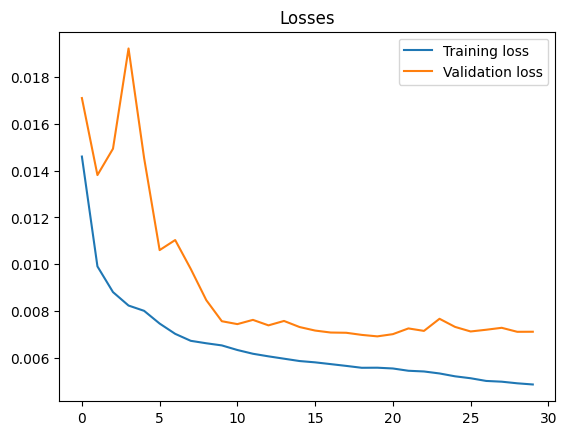

In [89]:
import torch.optim as optim

input_dim = len(X_train.columns)
output_dim = 1
hidden_dim = 64
layer_dim = 3
batch_size = 64
dropout = 0.2
n_epochs = 30
learning_rate = 1e-3
weight_decay = 1e-6

model_params = {
    "input_dim": input_dim,
    "hidden_dim": hidden_dim,
    "layer_dim": layer_dim,
    "output_dim": output_dim,
    "dropout_prob": dropout,
}

model = get_model("gru", model_params)

loss_fn = nn.MSELoss(reduction="mean")
optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=weight_decay)

opt = Optimization(model=model, loss_fn=loss_fn, optimizer=optimizer)
opt.train(
    train_loader,
    val_loader,
    batch_size=batch_size,
    n_epochs=n_epochs,
    n_features=input_dim,
)
opt.plot_losses()

predictions, values = opt.evaluate(test_loader_one, batch_size=1, n_features=input_dim)


In [90]:
def inverse_transform(scaler, df, columns):
    for col in columns:
        df[col] = scaler.inverse_transform(df[col])
    return df


def format_predictions(predictions, values, df_test, scaler):
    vals = np.concatenate(values, axis=0).ravel()
    preds = np.concatenate(predictions, axis=0).ravel()
    df_result = pd.DataFrame(
        data={"value": vals, "prediction": preds}, index=df_test.head(len(vals)).index
    )
    df_result = df_result.sort_index()
    df_result = inverse_transform(scaler, df_result, [["value", "prediction"]])
    return df_result


df_result = format_predictions(predictions, values, X_test, scaler)
df_result


In [91]:
df_result

,value,prediction
Datetime,,
2015-04-09 15:00:00,32204.0,29856.986328
2015-04-09 16:00:00,32049.0,29843.050781
2015-04-09 17:00:00,32209.0,30008.179688
2015-04-09 18:00:00,32707.0,30371.919922
2015-04-09 19:00:00,33012.0,30897.685547
...,...,...
2018-08-02 20:00:00,44057.0,46243.875000
2018-08-02 21:00:00,43256.0,44622.484375
2018-08-02 22:00:00,41552.0,42607.636719


In [92]:
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score


def calculate_metrics(df):
    return {
        "mae": mean_absolute_error(df.value, df.prediction),
        "rmse": mean_squared_error(df.value, df.prediction) ** 0.5,
        "r2": r2_score(df.value, df.prediction),
    }


result_metrics = calculate_metrics(df_result)

result_metrics


{'mae': 3086.4075, 'rmse': 4051.42987104553, 'r2': 0.6101681590080261}

In [93]:
# Построим baseline модель для сравнения
from sklearn.linear_model import LinearRegression


def build_baseline_model(df, test_ratio, target_col):
    X, y = feature_label_split(df, target_col)
    X_train, X_test, y_train, y_test = train_test_split(
        X, y, test_size=test_ratio, shuffle=False
    )
    model = LinearRegression()
    model.fit(X_train, y_train)
    prediction = model.predict(X_test)

    result = pd.DataFrame(y_test)
    result["prediction"] = prediction
    result = result.sort_index()

    return result


df_baseline = build_baseline_model(df_features, 0.2, "value")
baseline_metrics = calculate_metrics(df_baseline)


In [94]:
baseline_metrics

{'mae': 3545.165156153264, 'rmse': 4427.522804820611, 'r2': 0.5344329702558193}

**Визуализация прогнозов**

In [95]:
import plotly.offline as pyo


def plot_predictions(df_result, df_baseline):
    data = []

    value = go.Scatter(
        x=df_result.index,
        y=df_result.value,
        mode="lines",
        name="values",
        marker=dict(),
        text=df_result.index,
        line=dict(color="rgba(0,0,0, 0.3)"),
    )

    data.append(value)

    baseline = go.Scatter(
        x=df_baseline.index,
        y=df_baseline.prediction,
        mode="lines",
        line={"dash": "dot"},
        name="linear regression",
        marker=dict(),
        text=df_baseline.index,
        opacity=0.8,
    )

    data.append(baseline)

    prediction = go.Scatter(
        x=df_result.index,
        y=df_result.prediction,
        mode="lines",
        line={"dash": "dot"},
        name="predictions",
        marker=dict(),
        text=df_result.index,
        opacity=0.8,
    )

    data.append(prediction)

    layout = dict(
        title="Predictions vs Actual Values for the dataset",
        xaxis=dict(title="Time", ticklen=5, zeroline=False),
        yaxis=dict(title="Value", ticklen=5, zeroline=False),
    )

    fig = dict(data=data, layout=layout)

    iplot(fig)


# Set notebook mode to work in offline

pyo.init_notebook_mode()


plot_predictions(df_result, df_baseline)



RNN

[1/30] Training loss: 0.0138	 Validation loss: 0.0131
[2/30] Training loss: 0.0102	 Validation loss: 0.0155
[3/30] Training loss: 0.0093	 Validation loss: 0.0137
[4/30] Training loss: 0.0089	 Validation loss: 0.0129
[5/30] Training loss: 0.0087	 Validation loss: 0.0149
[6/30] Training loss: 0.0086	 Validation loss: 0.0135
[7/30] Training loss: 0.0082	 Validation loss: 0.0202
[8/30] Training loss: 0.0078	 Validation loss: 0.0106
[9/30] Training loss: 0.0078	 Validation loss: 0.0103
[10/30] Training loss: 0.0074	 Validation loss: 0.0101


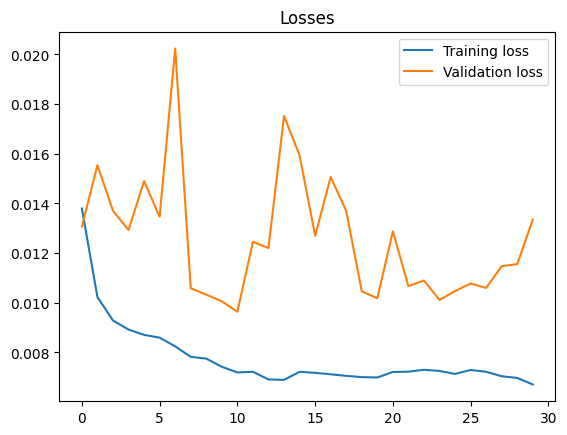

In [96]:
model = get_model("rnn", model_params)

loss_fn = nn.MSELoss(reduction="mean")
optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=weight_decay)

opt = Optimization(model=model, loss_fn=loss_fn, optimizer=optimizer)
opt.train(
    train_loader,
    val_loader,
    batch_size=batch_size,
    n_epochs=n_epochs,
    n_features=input_dim,
)
opt.plot_losses()

predictions, values = opt.evaluate(test_loader_one, batch_size=1, n_features=input_dim)


In [98]:
df_result = format_predictions(predictions, values, X_test, scaler)
df_result


,value,prediction
Datetime,,
2015-04-09 15:00:00,32204.0,30894.427734
2015-04-09 16:00:00,32049.0,31307.671875
2015-04-09 17:00:00,32209.0,31661.253906
2015-04-09 18:00:00,32707.0,31918.349609
2015-04-09 19:00:00,33012.0,32055.691406
...,...,...
2018-08-02 20:00:00,44057.0,36112.394531
2018-08-02 21:00:00,43256.0,34879.953125
2018-08-02 22:00:00,41552.0,32087.839844


In [99]:
def calculate_metrics(df):
    return {
        "mae": mean_absolute_error(df.value, df.prediction),
        "rmse": mean_squared_error(df.value, df.prediction) ** 0.5,
        "r2": r2_score(df.value, df.prediction),
    }


result_metrics = calculate_metrics(df_result)

result_metrics


{'mae': 3554.682, 'rmse': 4848.8225374826825, 'r2': 0.4416157007217407}

[1/30] Training loss: 0.0143	 Validation loss: 0.0170
[2/30] Training loss: 0.0092	 Validation loss: 0.0166
[3/30] Training loss: 0.0084	 Validation loss: 0.0104
[4/30] Training loss: 0.0078	 Validation loss: 0.0096
[5/30] Training loss: 0.0074	 Validation loss: 0.0082
[6/30] Training loss: 0.0070	 Validation loss: 0.0078
[7/30] Training loss: 0.0067	 Validation loss: 0.0074
[8/30] Training loss: 0.0064	 Validation loss: 0.0073
[9/30] Training loss: 0.0063	 Validation loss: 0.0073
[10/30] Training loss: 0.0061	 Validation loss: 0.0071


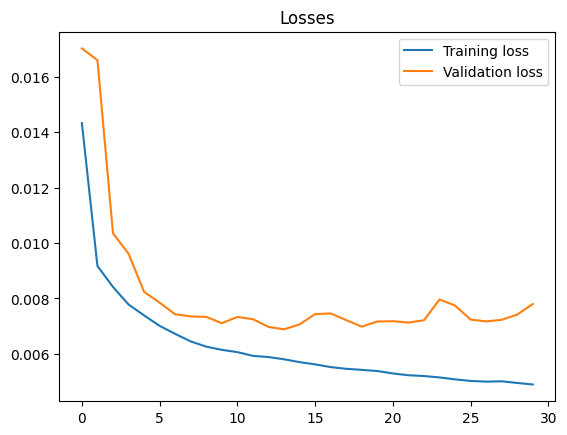

In [100]:
model = get_model("lstm", model_params)

loss_fn = nn.MSELoss(reduction="mean")
optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=weight_decay)

opt = Optimization(model=model, loss_fn=loss_fn, optimizer=optimizer)
opt.train(
    train_loader,
    val_loader,
    batch_size=batch_size,
    n_epochs=n_epochs,
    n_features=input_dim,
)
opt.plot_losses()

predictions, values = opt.evaluate(test_loader_one, batch_size=1, n_features=input_dim)


In [101]:
df_result = format_predictions(predictions, values, X_test, scaler)
df_result


,value,prediction
Datetime,,
2015-04-09 15:00:00,32204.0,29034.525391
2015-04-09 16:00:00,32049.0,28856.062500
2015-04-09 17:00:00,32209.0,28895.642578
2015-04-09 18:00:00,32707.0,29176.396484
2015-04-09 19:00:00,33012.0,29580.830078
...,...,...
2018-08-02 20:00:00,44057.0,45206.109375
2018-08-02 21:00:00,43256.0,43404.648438
2018-08-02 22:00:00,41552.0,41159.675781


In [102]:
def calculate_metrics(df):
    return {
        "mae": mean_absolute_error(df.value, df.prediction),
        "rmse": mean_squared_error(df.value, df.prediction) ** 0.5,
        "r2": r2_score(df.value, df.prediction),
    }


result_metrics = calculate_metrics(df_result)

result_metrics


{'mae': 2884.3708, 'rmse': 3862.941107498275, 'r2': 0.6455974578857422}